In [412]:
import numpy as np
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk
nltk.download('vader_lexicon')
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
import scipy.stats as stats


[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\enabi\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [305]:
df1= pd.read_csv('calendar.csv')

In [306]:
df1.head()

,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
2,241032,2016-01-06,f,NaN
3,241032,2016-01-07,f,NaN
4,241032,2016-01-08,f,NaN


In [386]:
df2= pd.read_csv('listings.csv')

In [527]:
df2.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,...,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,24-Hour Check-in,Air Conditioning,Breakfast,Buzzer/Wireless Intercom,Cable TV,Carbon Monoxide Detector,Cat(s),Dog(s),Doorman,Dryer,Elevator in Building,Essentials,Family/Kid Friendly,Fire Extinguisher,First Aid Kit,Free Parking on Premises,Gym,Hair Dryer,Hangers,Heating,Hot Tub,Indoor Fireplace,Internet,Iron,Kitchen,Laptop Friendly Workspace,Lock on Bedroom Door,Other pet(s),Pets Allowed,Pets live on this property,Pool,Safety Card,Shampoo,Smoke Detector,Smoking Allowed,Suitable for Events,TV,Washer,Washer / Dryer,Wheelchair Accessible,Wireless Internet,months_since_reference
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.636289,-122.371025,t,Apartment,Entire home/apt,...,NaN,WASHINGTON,f,moderate,f,f,2,4.07,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,142.0
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.639123,-122.365666,t,Apartment,Entire home/apt,...,NaN,WASHINGTON,f,strict,t,t,6,1.48,0,0,0,1,0,1,0,0,0,1,0,1,1,1,1,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,124.0


In [309]:
df3= pd.read_csv('reviews.csv')

In [310]:
df3.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,7202016,38917982,2015-07-19,28943674,Bianca,Cute and cozy place. Perfect location to every...
1,7202016,39087409,2015-07-20,32440555,Frank,Kelly has a great room in a very central locat...
2,7202016,39820030,2015-07-26,37722850,Ian,"Very spacious apartment, and in a great neighb..."
3,7202016,40813543,2015-08-02,33671805,George,Close to Seattle Center and all it has to offe...
4,7202016,41986501,2015-08-10,34959538,Ming,Kelly was a great host and very accommodating ...


In [311]:
df1.shape

(1393570, 4)

In [312]:
df2.shape

(3818, 92)

In [313]:
df3.shape

(84849, 6)

In [314]:
# Can you describe the vibe of each Seattle neighborhood using listing descriptions?

In [315]:
df2['neighbourhood']

0        Queen Anne
1        Queen Anne
2        Queen Anne
3        Queen Anne
4        Queen Anne
           ...     
3813        Fremont
3814    Portage Bay
3815            NaN
3816            NaN
3817     Queen Anne
Name: neighbourhood, Length: 3818, dtype: object

In [316]:
df2['neighborhood_overview'].value_counts(dropna=False)

NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                     

In [317]:
df2['neighborhood_overview'].fillna('', inplace=True)

In [318]:
df2['neighborhood_overview'].value_counts(dropna=False)

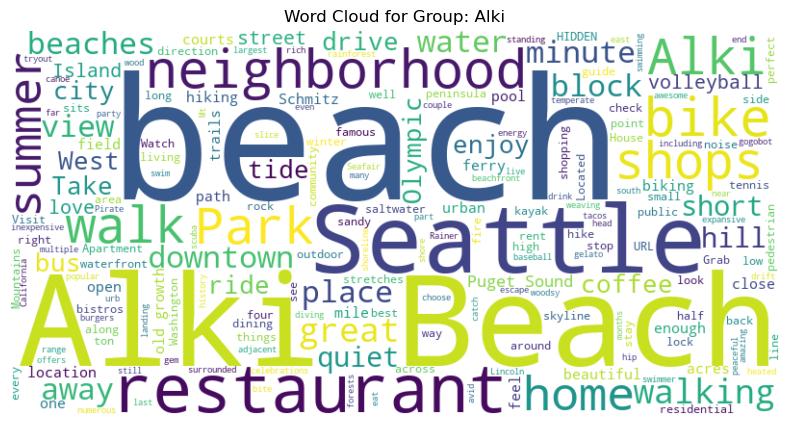

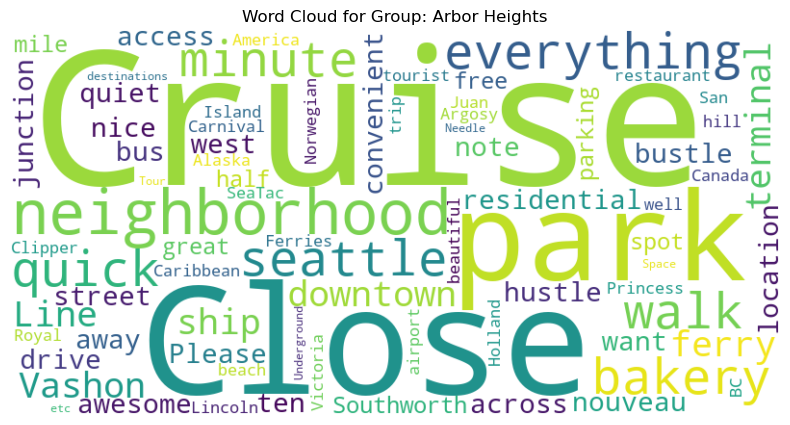

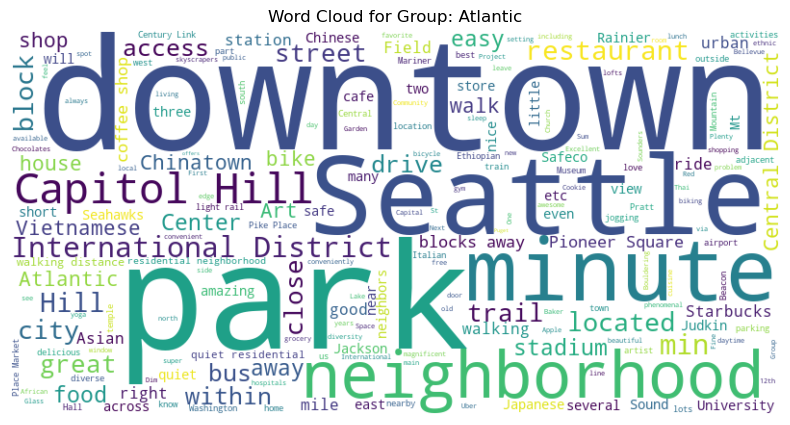

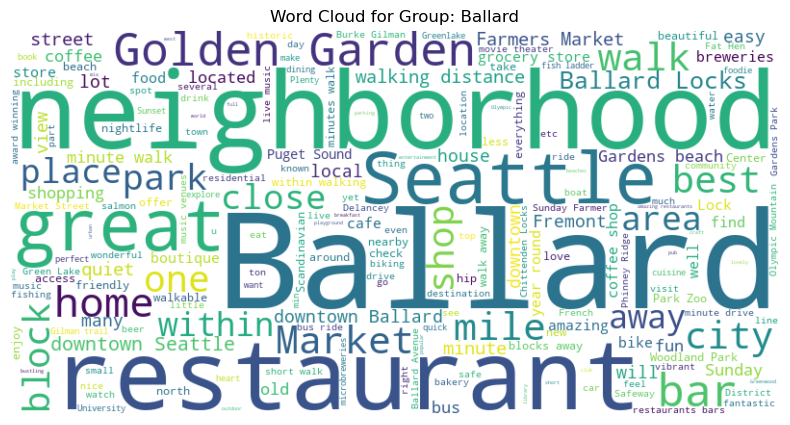

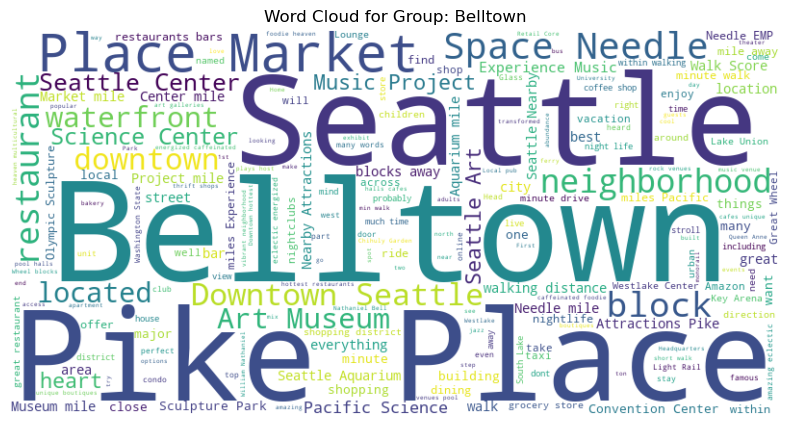

...

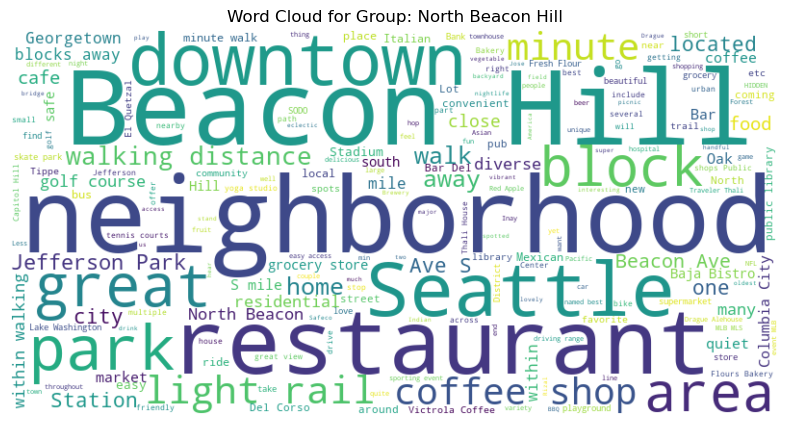

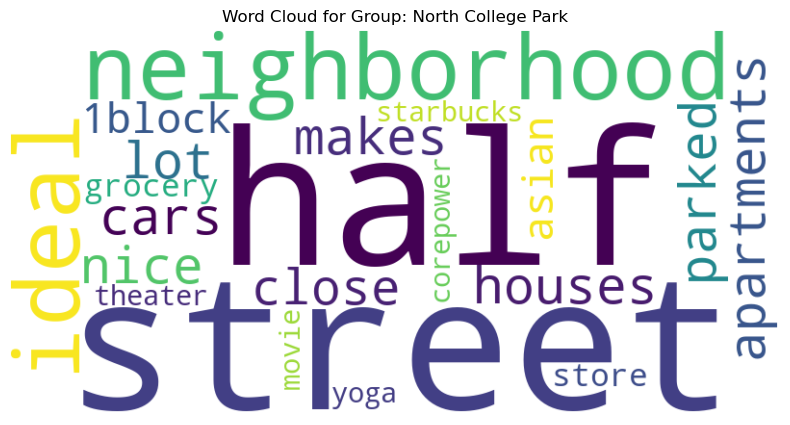

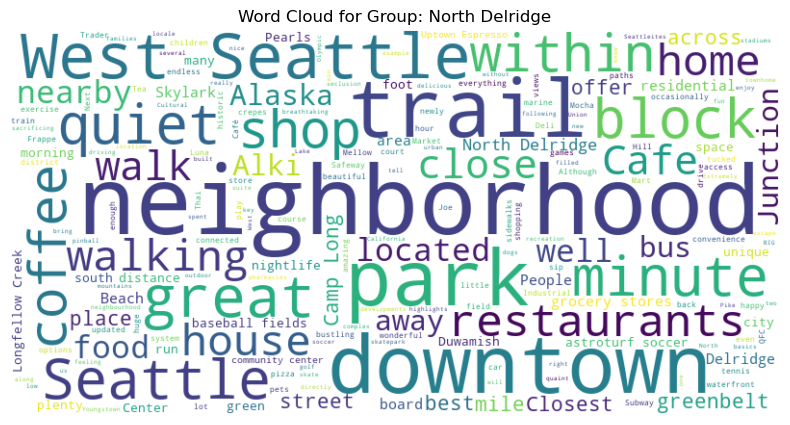

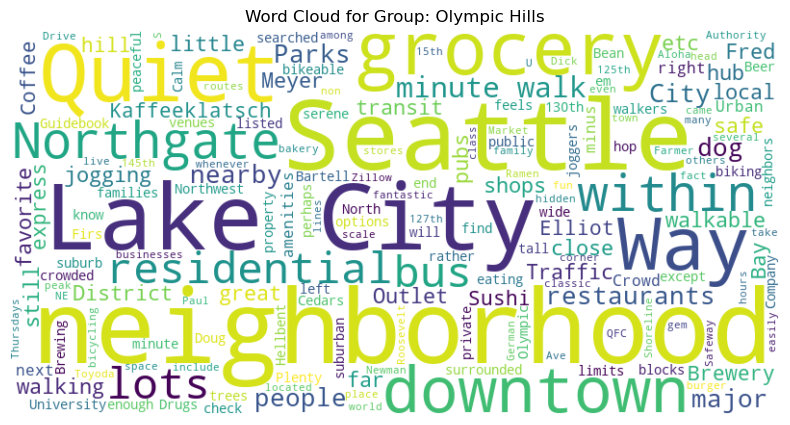

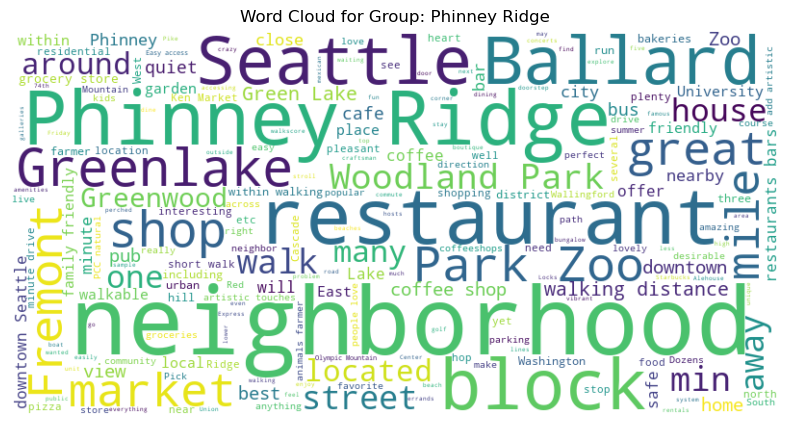

ValueError: We need at least 1 word to plot a word cloud, got 0.

In [319]:
# WordCloud
grouped = df2.groupby('neighbourhood')['neighborhood_overview'].apply(lambda x: ' '.join(x)).reset_index()

# Generate word clouds for each group
for index, row in grouped.iterrows():
    group = str(row['neighbourhood'])
    text = str(row['neighborhood_overview'])

    # Create word cloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

    # Plot the word cloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(f'Word Cloud for Group: {group}')
    plt.axis('off')
    plt.show()

In [320]:
# Sentiment analysis

# Initialize the SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()

# Perform sentiment analysis grouped by another column
grouped_sentiments = df2.groupby('neighbourhood')['neighborhood_overview'].apply(lambda x: x.apply(lambda y: sia.polarity_scores(y)['compound']).mean()).reset_index()
grouped_sentiments.columns = ['neighbourhood', 'group_sentiment']

# Merge the sentiment analysis results with the original dataset
# df2 = df2.merge(grouped_sentiments, on='neighbourhood', how='left')

# Classify sentiment based on the compound score
grouped_sentiments['sentiment_label'] = grouped_sentiments['group_sentiment'].apply(lambda x: 'Positive' if x >= 0 else 'Negative')

# Print the sentiment analysis results
print(grouped_sentiments[['neighbourhood', 'group_sentiment', 'sentiment_label']])

                neighbourhood  group_sentiment sentiment_label
0                        Alki         0.476404        Positive
1               Arbor Heights         0.843067        Positive
2                    Atlantic         0.316466        Positive
3                     Ballard         0.572011        Positive
4                    Belltown         0.311897        Positive
5                 Bitter Lake         0.409754        Positive
6                    Brighton         0.765220        Positive
7                   Broadview         0.440488        Positive
8                    Broadway         0.538620        Positive
9                      Bryant         0.568131        Positive
10               Capitol Hill         0.422537        Positive
11                 Cedar Park         0.190513        Positive
12  Central Business District         0.147096        Positive
13              Columbia City         0.556169        Positive
14                 Crown Hill         0.565281        P

In [321]:
grouped_sentiments['sentiment_label'].value_counts(dropna=False)

Positive    81
Name: sentiment_label, dtype: int64

In [326]:
# part-of-speech (POS) tagging

#Tokenize the text data
df2['tokenized_text'] = df2.groupby('neighbourhood')['neighborhood_overview'].transform(lambda x: x.apply(nltk.word_tokenize))

# Perform POS tagging on each tokenized text
df2['pos_tags'] = df2['tokenized_text'].apply(lambda x: nltk.pos_tag(x) if isinstance(x, list) else [])

# Print the POS tags
print(df2[['neighbourhood', 'neighborhood_overview', 'pos_tags']])

     neighbourhood                              neighborhood_overview  \
0       Queen Anne                                                      
1       Queen Anne  Queen Anne is a wonderful, truly functional vi...   
2       Queen Anne  Upper Queen Anne is a charming neighborhood fu...   
3       Queen Anne                                                      
4       Queen Anne  We are in the beautiful neighborhood of Queen ...   
...            ...                                                ...   
3813       Fremont  We're located near lots of family fun. Woodlan...   
3814   Portage Bay  The neighborhood is a quiet oasis that is clos...   
3815           NaN                                                      
3816           NaN  Madison Park offers a peaceful slow pace upsca...   
3817    Queen Anne                                                      

                                               pos_tags  
0                                                    []  
1     [

In [323]:
#df2['tokenized_text']

In [324]:
# named entity recognition (NER)

# Define a function to perform NER on each text
def ner_tagging(text):
    tokens = nltk.word_tokenize(text)
    tagged = nltk.pos_tag(tokens)
    return nltk.ne_chunk(tagged)

# Perform NER grouped by another column
df2['ner_tags'] = df2.groupby('neighbourhood')['neighborhood_overview'].transform(lambda x: x.apply(ner_tagging))

# Print the NER tags
print(df2[['neighbourhood', 'neighborhood_overview', 'ner_tags']])

     neighbourhood                              neighborhood_overview  \
0       Queen Anne                                                      
1       Queen Anne  Queen Anne is a wonderful, truly functional vi...   
2       Queen Anne  Upper Queen Anne is a charming neighborhood fu...   
3       Queen Anne                                                      
4       Queen Anne  We are in the beautiful neighborhood of Queen ...   
...            ...                                                ...   
3813       Fremont  We're located near lots of family fun. Woodlan...   
3814   Portage Bay  The neighborhood is a quiet oasis that is clos...   
3815           NaN                                                      
3816           NaN  Madison Park offers a peaceful slow pace upsca...   
3817    Queen Anne                                                      

                                               ner_tags  
0                                                    []  
1     [

In [325]:
df2['pos_tags'][1]

KeyError: 'pos_tags'

In [ ]:
df2['ner_tags'][1]

In [ ]:
diference between  second one's result is a tree 

C:\Users\enabi\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


                neighbourhood  cluster_label
0                        Alki              4
1               Arbor Heights              1
2                    Atlantic              4
3                     Ballard              4
4                    Belltown              0
5                 Bitter Lake              4
6                    Brighton              4
7                   Broadview              4
8                    Broadway              4
9                      Bryant              4
10               Capitol Hill              0
11                 Cedar Park              4
12  Central Business District              0
13              Columbia City              4
14                 Crown Hill              4
15                     Dunlap              4
16                   Eastlake              4
17             Fairmount Park              1
18                 Fauntleroy              4
19                 First Hill              0
20                    Fremont              4
21        

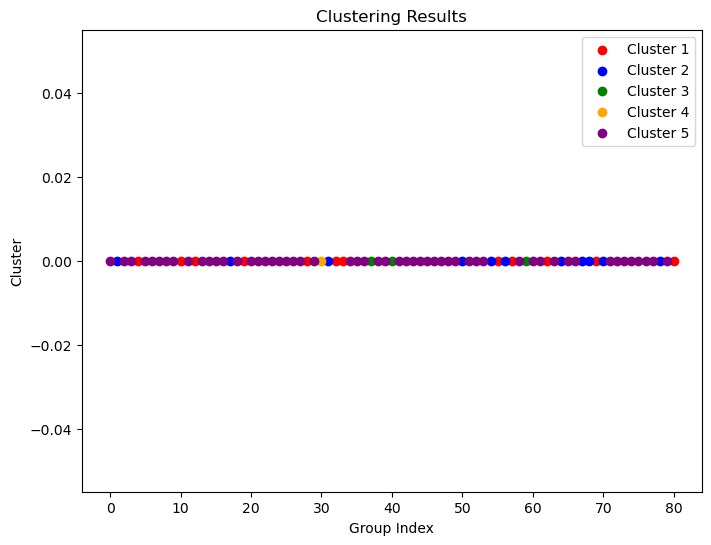

In [327]:
# Clustering with K-means
grouped_texts = df2.groupby('neighbourhood')['neighborhood_overview'].apply(' '.join).reset_index()

# Vectorize the text data
vectorizer = TfidfVectorizer()
vectorized_data = vectorizer.fit_transform(grouped_texts['neighborhood_overview'])

# Perform clustering using K-means
num_clusters = 5  # Define the number of clusters
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(vectorized_data)

# Add the cluster labels to the grouped data
grouped_texts['cluster_label'] = kmeans.labels_

# Print the cluster labels
print(grouped_texts[['neighbourhood', 'cluster_label']])

# Plot the clustering results
plt.figure(figsize=(8, 6))
colors = ['red', 'blue', 'green', 'orange', 'purple']  # Define colors for each cluster
for label, color in zip(range(num_clusters), colors):
    cluster_data = grouped_texts[grouped_texts['cluster_label'] == label]
    plt.scatter(cluster_data.index, [0] * len(cluster_data), color=color, label=f'Cluster {label+1}')

plt.title('Clustering Results')
plt.xlabel('Group Index')
plt.ylabel('Cluster')
plt.legend()
plt.show()

In [328]:
vectorized_data

<81x6887 sparse matrix of type '<class 'numpy.float64'>'
	with 36637 stored elements in Compressed Sparse Row format>

In [329]:
# Topic Modeling with LDA

# Group by another column and perform topic modeling
grouped_texts = df2.groupby('neighbourhood')['neighborhood_overview'].apply(' '.join).reset_index()

# Vectorize the text data
vectorizer = CountVectorizer()
vectorized_data = vectorizer.fit_transform(grouped_texts['neighborhood_overview'])

# Perform topic modeling using LDA
num_topics = 5  # Define the number of topics
lda = LatentDirichletAllocation(n_components=num_topics, random_state=42)
lda.fit(vectorized_data)

# Get the dominant topic for each group
dominant_topic = lda.transform(vectorized_data).argmax(axis=1)
grouped_texts['topic_label'] = dominant_topic

# Print the topic labels
print(grouped_texts[['neighbourhood', 'topic_label']])


                neighbourhood  topic_label
0                        Alki            2
1               Arbor Heights            2
2                    Atlantic            2
3                     Ballard            4
4                    Belltown            0
5                 Bitter Lake            2
6                    Brighton            2
7                   Broadview            2
8                    Broadway            2
9                      Bryant            2
10               Capitol Hill            2
11                 Cedar Park            2
12  Central Business District            0
13              Columbia City            2
14                 Crown Hill            2
15                     Dunlap            2
16                   Eastlake            4
17             Fairmount Park            4
18                 Fauntleroy            2
19                 First Hill            0
20                    Fremont            2
21                   Gatewood            2
22         

In [330]:
import nltk
nltk.download('averaged_perceptron_tagger')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\enabi\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


True

In [331]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\enabi\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [332]:
import nltk
nltk.download('maxent_ne_chunker')

[nltk_data] Downloading package maxent_ne_chunker to
[nltk_data]     C:\Users\enabi\AppData\Roaming\nltk_data...
[nltk_data]   Package maxent_ne_chunker is already up-to-date!


True

In [333]:
import nltk
nltk.download('words')

[nltk_data] Downloading package words to
[nltk_data]     C:\Users\enabi\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


True

In [334]:
# By how much do prices vary in different months?

In [335]:
df1.head()

,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
2,241032,2016-01-06,f,NaN
3,241032,2016-01-07,f,NaN
4,241032,2016-01-08,f,NaN


In [336]:
min (df1['date'])

'2016-01-04'

In [337]:
max (df1['date'])

'2017-01-02'

In [338]:
# Convert the 'Date' column to datetime type
df1['date'] = pd.to_datetime(df1['date'])

# Extract the month from the 'Date' column
df1['Month'] = df1['date'].dt.month

In [339]:
df1['Month']

0           1
1           1
2           1
3           1
4           1
           ..
1393565    12
1393566    12
1393567    12
1393568     1
1393569     1
Name: Month, Length: 1393570, dtype: int64

In [340]:
df1['available'].value_counts(dropna=False)

t    934542
f    459028
Name: available, dtype: int64

In [341]:
df1['price']= df1['price'].str.replace('$','')
df1['price']

C:\Users\enabi\AppData\Local\Temp\ipykernel_520\20900118.py:1: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df1['price']= df1['price'].str.replace('$','')


0          85.00
1          85.00
2            NaN
3            NaN
4            NaN
           ...  
1393565      NaN
1393566      NaN
1393567      NaN
1393568      NaN
1393569      NaN
Name: price, Length: 1393570, dtype: object

In [342]:
df1['price'].dtype

dtype('O')

In [343]:
df1['price'].value_counts(dropna=False)

NaN       459028
150.00     36646
100.00     31755
75.00      29820
125.00     27538
           ...  
751.00         1
759.00         1
12.00          1
685.00         1
554.00         1
Name: price, Length: 670, dtype: int64

In [344]:
df1['price'] = pd.to_numeric(df1['price'], errors='coerce')

In [345]:
s =pd.DataFrame(df1.loc[df1['available'] =='t'].groupby('Month')['price'].mean())
s.reset_index(drop=False, inplace=True)

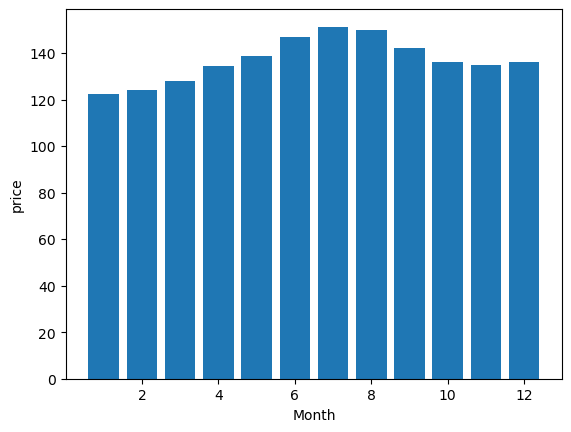

In [346]:
x_data = s['Month']
y_data = s['price']

plt.bar(x_data, y_data)

# Set labels for x and y axes
plt.xlabel('Month')
plt.ylabel('price')

# Show the plot
plt.show()

In [347]:
df2.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,ner_tags,tokenized_text,pos_tags
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.636289,-122.371025,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,$85.00,NaN,NaN,NaN,NaN,2,$5.00,1,365,4 weeks ago,t,14,41,71,346,2016-01-04,207,2011-11-01,2016-01-02,95.0,10.0,10.0,10.0,10.0,9.0,10.0,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07,[],[],[]
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.639123,-122.365666,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",NaN,$150.00,"$1,000.00","$3,000.00",$100.00,$40.00,1,$0.00,2,90,today,t,13,13,16,291,2016-01-04,43,2013-08-19,2015-12-29,96.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,WASHINGTON,f,strict,t,t,6,1.48,"[(Queen, JJ), [(Anne, NNP)], (is, VBZ), (a, DT...","[Qu

In [348]:
df1.shape

(1393570, 5)

In [349]:
df1['listing_id'].nunique()

3818

In [350]:
df2.shape

(3818, 95)

In [351]:
df2['neighbourhood'].value_counts(dropna=False)

NaN                          416
Capitol Hill                 351
Ballard                      213
Belltown                     204
Minor                        192
Queen Anne                   187
Fremont                      148
Wallingford                  143
University District          107
First Hill                   105
Stevens                       98
North Beacon Hill             95
Lower Queen Anne              83
Central Business District     81
Greenwood                     79
Columbia City                 61
Ravenna                       59
Phinney Ridge                 56
Magnolia                      55
Green Lake                    52
Atlantic                      50
North Admiral                 48
Mount Baker                   46
Leschi                        44
Maple Leaf                    41
Eastlake                      41
Madrona                       40
Pike Place Market             39
The Junction                  36
Seward Park                   32
Bryant    

In [352]:

# Merge df2 with the selected column from df1 based on the 'ID' column
merged_df = pd.merge(df1, df2[['id','neighbourhood']], left_on='listing_id', right_on='id', how='left')


In [353]:
merged_df.tail()

,listing_id,date,available,price,Month,id,neighbourhood
1393565,10208623,2016-12-29,f,NaN,12,10208623,Queen Anne
1393566,10208623,2016-12-30,f,NaN,12,10208623,Queen Anne
1393567,10208623,2016-12-31,f,NaN,12,10208623,Queen Anne
1393568,10208623,2017-01-01,f,NaN,1,10208623,Queen Anne
1393569,10208623,2017-01-02,f,NaN,1,10208623,Queen Anne


In [354]:
merged_df.shape

(1393570, 7)

In [355]:
merged_df['neighbourhood'].value_counts(dropna=False)

NaN                          151840
Capitol Hill                 128115
Ballard                       77745
Belltown                      74460
Minor                         70080
Queen Anne                    68255
Fremont                       54020
Wallingford                   52195
University District           39055
First Hill                    38325
Stevens                       35770
North Beacon Hill             34675
Lower Queen Anne              30295
Central Business District     29565
Greenwood                     28835
Columbia City                 22265
Ravenna                       21535
Phinney Ridge                 20440
Magnolia                      20075
Green Lake                    18980
Atlantic                      18250
North Admiral                 17520
Mount Baker                   16790
Leschi                        16060
Maple Leaf                    14965
Eastlake                      14965
Madrona                       14600
Pike Place Market           

In [356]:
s2 =pd.DataFrame(merged_df.loc[df1['available'] =='t'].groupby(['Month', 'neighbourhood'])['price'].mean())
s2.reset_index(drop=False, inplace=True)

In [357]:
s2.head()

,Month,neighbourhood,price
0,1,Alki,199.232409
1,1,Arbor Heights,82.727273
2,1,Atlantic,114.507082
3,1,Ballard,109.902842
4,1,Belltown,158.133207


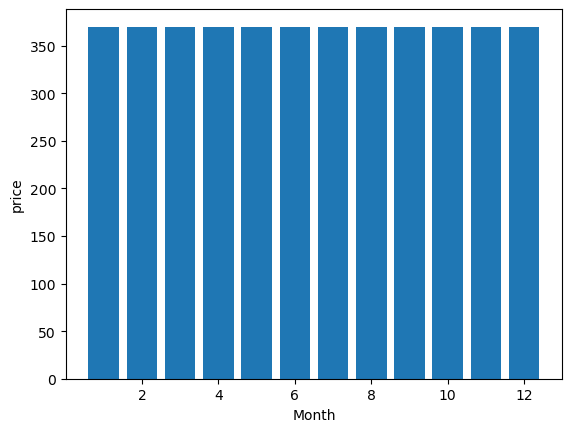

In [358]:
x_data = s2['Month']
y_data = s2['price']

plt.bar(x_data, y_data)

# Set labels for x and y axes
plt.xlabel('Month')
plt.ylabel('price')

# Show the plot
plt.show()

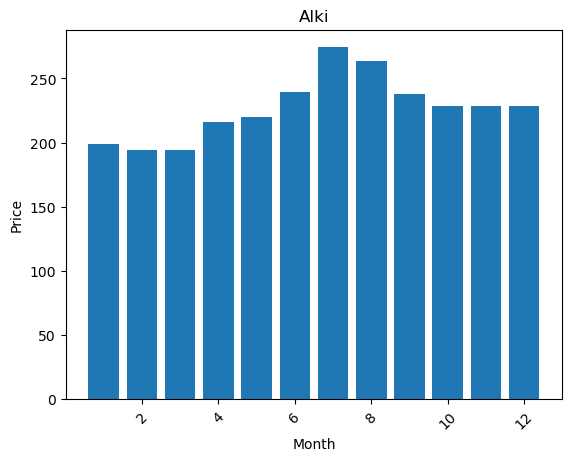

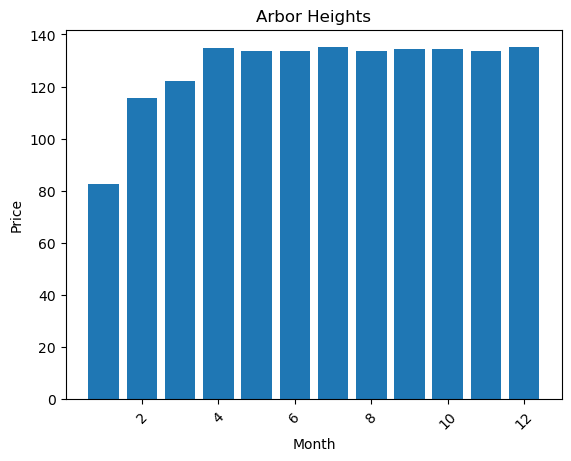

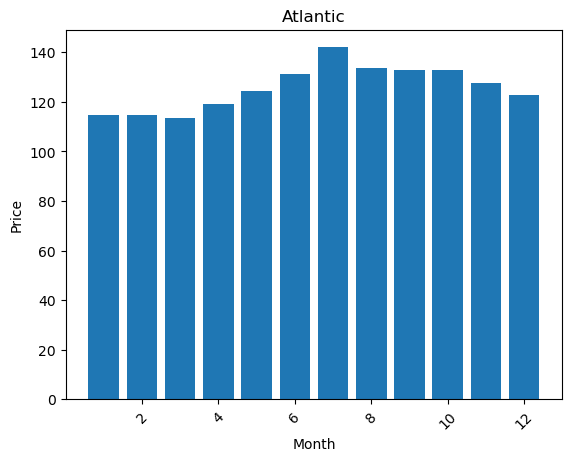

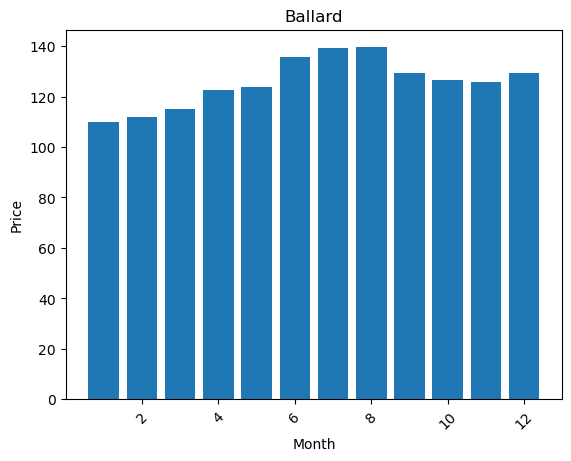

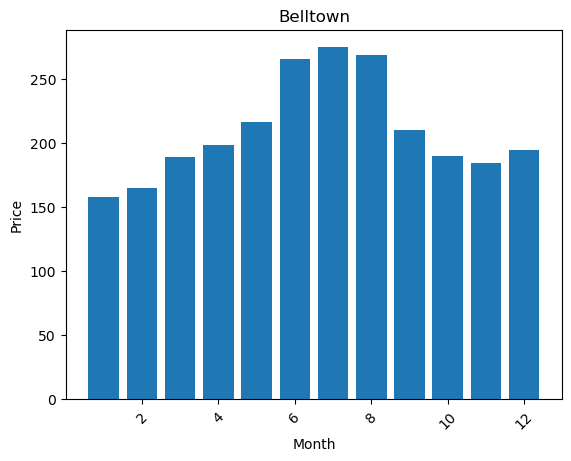

...

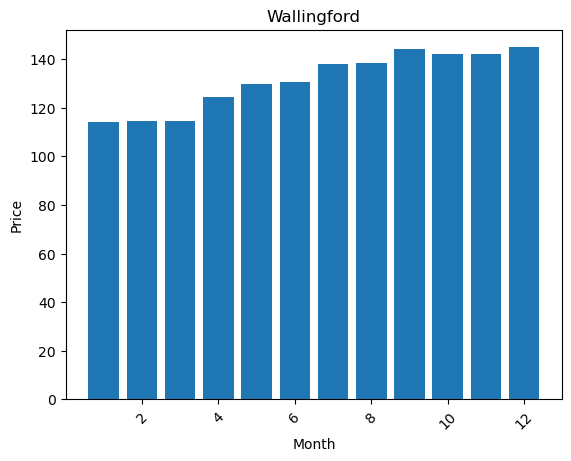

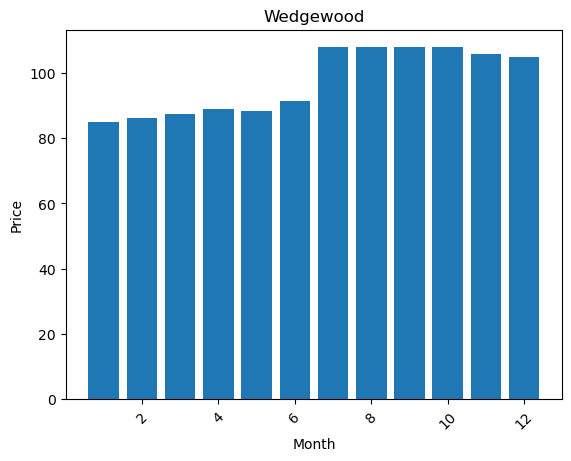

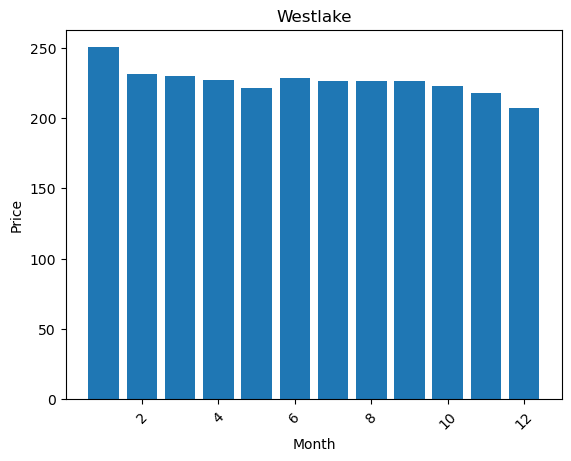

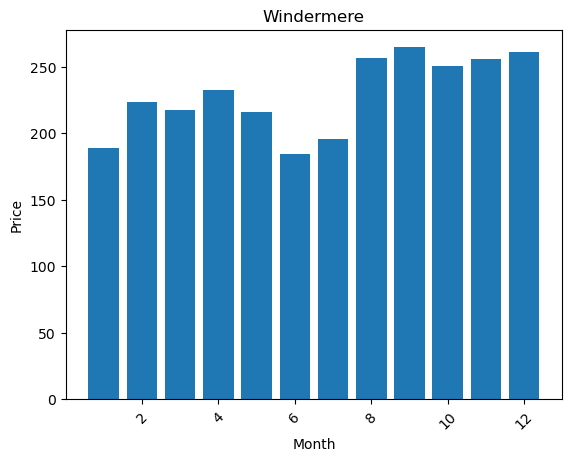

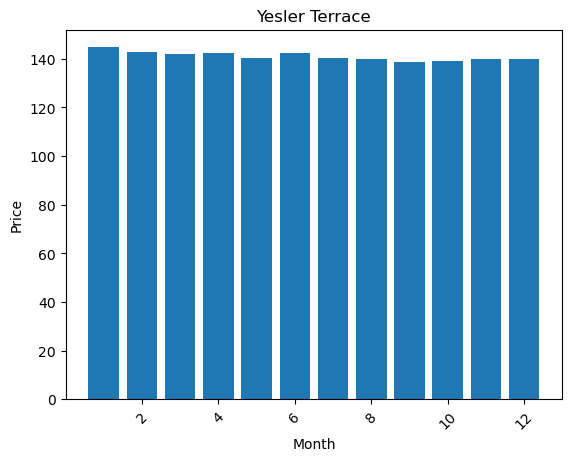

In [359]:

# Group the dataframe by 'neighborhood' column
grouped_df = s2.groupby('neighbourhood')

# Create bar charts for each neighborhood
for neighborhood, data in grouped_df:
    plt.figure()  # Create a new figure for each neighborhood
    plt.bar(data['Month'], data['price'])
    plt.xlabel('Month')
    plt.ylabel('Price')
    plt.title(neighborhood)

    # Optional: Rotate x-axis labels if needed
    plt.xticks(rotation=45)

    # Show the plot for the current neighborhood
    plt.show()

In [360]:
#  Is there a general upward trend of new Airbnb listings

In [361]:
merged_df.head()

,listing_id,date,available,price,Month,id,neighbourhood
0,241032,2016-01-04,t,85.0,1,241032,Queen Anne
1,241032,2016-01-05,t,85.0,1,241032,Queen Anne
2,241032,2016-01-06,f,NaN,1,241032,Queen Anne
3,241032,2016-01-07,f,NaN,1,241032,Queen Anne
4,241032,2016-01-08,f,NaN,1,241032,Queen Anne


In [362]:
merged_df['date'].max()

Timestamp('2017-01-02 00:00:00')

In [363]:
merged_df.groupby(['Month'])['listing_id'].nunique()

Month
1     3818
2     3818
3     3818
4     3818
5     3818
6     3818
7     3818
8     3818
9     3818
10    3818
11    3818
12    3818
Name: listing_id, dtype: int64

In [364]:
merged_df.loc[merged_df['available']=='t'].groupby(['Month'])['listing_id'].nunique()

Month
1     3623
2     2895
3     2950
4     3002
5     2705
6     2720
7     2503
8     2561
9     2649
10    2694
11    2771
12    2866
Name: listing_id, dtype: int64

In [393]:
c1=list(df2.columns)

In [394]:
print(df2['amenities'])

0       {TV,"Cable TV",Internet,"Wireless Internet","A...
1       {TV,Internet,"Wireless Internet",Kitchen,"Free...
2       {TV,"Cable TV",Internet,"Wireless Internet","A...
3       {Internet,"Wireless Internet",Kitchen,"Indoor ...
4       {TV,"Cable TV",Internet,"Wireless Internet",Ki...
                              ...                        
3813    {TV,"Cable TV",Internet,"Wireless Internet","A...
3814    {TV,"Cable TV",Internet,"Wireless Internet",Ki...
3815    {"Cable TV","Wireless Internet",Kitchen,"Free ...
3816    {TV,"Wireless Internet",Kitchen,"Free Parking ...
3817    {TV,"Cable TV",Internet,"Wireless Internet",Ki...
Name: amenities, Length: 3818, dtype: object


In [395]:
dummy_df = pd.get_dummies(df2['amenities'].apply(pd.Series).stack()).sum(level=0)

# Concatenate the original dataframe with the dummy variables
df_with_dummies = pd.concat([df2, dummy_df], axis=1)

C:\Users\enabi\AppData\Local\Temp\ipykernel_520\1630628043.py:1: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  dummy_df = pd.get_dummies(df2['amenities'].apply(pd.Series).stack()).sum(level=0)


In [396]:
df2.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.636289,-122.371025,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,$85.00,NaN,NaN,NaN,NaN,2,$5.00,1,365,4 weeks ago,t,14,41,71,346,2016-01-04,207,2011-11-01,2016-01-02,95.0,10.0,10.0,10.0,10.0,9.0,10.0,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.639123,-122.365666,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",NaN,$150.00,"$1,000.00","$3,000.00",$100.00,$40.00,1,$0.00,2,90,today,t,13,13,16,291,2016-01-04,43,2013-08-19,2015-12-29,96.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,WASHINGTON,f,strict,t,t,6,1.48


In [397]:
df2.shape

(3818, 92)

In [398]:
df2['amenities']=df2['amenities'].str.replace('"','')
df2['amenities']=df2['amenities'].str.replace('{','')
df2['amenities']=df2['amenities'].str.replace('}','')
df2['amenities']=df2['amenities'].str.split(',')
df2 = pd.concat([df2,pd.get_dummies(df2['amenities'].apply(pd.Series).stack()).sum(level=0)], axis=1)

C:\Users\enabi\AppData\Local\Temp\ipykernel_520\1588641760.py:2: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df2['amenities']=df2['amenities'].str.replace('{','')
C:\Users\enabi\AppData\Local\Temp\ipykernel_520\1588641760.py:3: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df2['amenities']=df2['amenities'].str.replace('}','')
C:\Users\enabi\AppData\Local\Temp\ipykernel_520\1588641760.py:5: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  df2 = pd.concat([df2,pd.get_dummies(df2['amenities'].apply(pd.Series).stack()).su

In [399]:
del df2['']

In [400]:
df2.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,...,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,24-Hour Check-in,Air Conditioning,Breakfast,Buzzer/Wireless Intercom,Cable TV,Carbon Monoxide Detector,Cat(s),Dog(s),Doorman,Dryer,Elevator in Building,Essentials,Family/Kid Friendly,Fire Extinguisher,First Aid Kit,Free Parking on Premises,Gym,Hair Dryer,Hangers,Heating,Hot Tub,Indoor Fireplace,Internet,Iron,Kitchen,Laptop Friendly Workspace,Lock on Bedroom Door,Other pet(s),Pets Allowed,Pets live on this property,Pool,Safety Card,Shampoo,Smoke Detector,Smoking Allowed,Suitable for Events,TV,Washer,Washer / Dryer,Wheelchair Accessible,Wireless Internet
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.636289,-122.371025,t,Apartment,Entire home/apt,...,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.639123,-122.365666,t,Apartment,Entire home/apt,...,f,NaN,WASHINGTON,f,strict,t,t,6,1.48,0,0,0,1,0,1,0,0,0,1,0,1,1,1,1,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1


In [401]:
df2['amenities']

0       [TV, Cable TV, Internet, Wireless Internet, Ai...
1       [TV, Internet, Wireless Internet, Kitchen, Fre...
2       [TV, Cable TV, Internet, Wireless Internet, Ai...
3       [Internet, Wireless Internet, Kitchen, Indoor ...
4       [TV, Cable TV, Internet, Wireless Internet, Ki...
                              ...                        
3813    [TV, Cable TV, Internet, Wireless Internet, Ai...
3814    [TV, Cable TV, Internet, Wireless Internet, Ki...
3815    [Cable TV, Wireless Internet, Kitchen, Free Pa...
3816    [TV, Wireless Internet, Kitchen, Free Parking ...
3817    [TV, Cable TV, Internet, Wireless Internet, Ki...
Name: amenities, Length: 3818, dtype: object

In [402]:
c2= list(df2.columns)

In [407]:
a=list(set(c2)-set(c1))

In [409]:
a

['Lock on Bedroom Door',
 'Washer',
 'Family/Kid Friendly',
 'Essentials',
 'Hair Dryer',
 'Wheelchair Accessible',
 'Other pet(s)',
 'Safety Card',
 'TV',
 'Fire Extinguisher',
 'Heating',
 'Cat(s)',
 'Dog(s)',
 'Iron',
 'Hot Tub',
 'Dryer',
 'Pets live on this property',
 'Internet',
 'Kitchen',
 'Laptop Friendly Workspace',
 'Buzzer/Wireless Intercom',
 'Hangers',
 'Breakfast',
 'Suitable for Events',
 'Wireless Internet',
 'Shampoo',
 'Pets Allowed',
 'Doorman',
 'Cable TV',
 'Pool',
 'Free Parking on Premises',
 '24-Hour Check-in',
 'Smoking Allowed',
 'Washer / Dryer',
 'Air Conditioning',
 'Elevator in Building',
 'Carbon Monoxide Detector',
 'Indoor Fireplace',
 'Smoke Detector',
 'First Aid Kit',
 'Gym']

In [415]:
len(a)

41

In [403]:
df2['review_scores_rating']

0        95.0
1        96.0
2        97.0
3         NaN
4        92.0
        ...  
3813     80.0
3814    100.0
3815      NaN
3816      NaN
3817      NaN
Name: review_scores_rating, Length: 3818, dtype: float64

In [411]:
# Which amenities attracts more satisfaction?
for c in a:
    print(df2.groupby(df2[c])['review_scores_rating'].mean())

Lock on Bedroom Door
0    94.530789
1    95.037736
Name: review_scores_rating, dtype: float64
Washer
0    94.510174
1    94.547322
Name: review_scores_rating, dtype: float64
Family/Kid Friendly
0    94.450601
1    94.618649
Name: review_scores_rating, dtype: float64
Essentials
0    93.312360
1    94.739545
Name: review_scores_rating, dtype: float64
Hair Dryer
0    94.363849
1    95.284768
Name: review_scores_rating, dtype: float64
Wheelchair Accessible
0    94.558108
1    94.322835
Name: review_scores_rating, dtype: float64
Other pet(s)
0    94.530691
1    95.162791
Name: review_scores_rating, dtype: float64
Safety Card
0    94.194586
1    95.951768
Name: review_scores_rating, dtype: float64
TV
0    93.819066
1    94.884741
Name: review_scores_rating, dtype: float64
Fire Extinguisher
0    93.623485
1    95.192328
Name: review_scores_rating, dtype: float64
Heating
0    93.290323
1    94.590089
Name: review_scores_rating, dtype: float64
Cat(s)
0    94.389807
1    95.843558
Name: review_s

In [432]:

# Define a function to calculate p-value
def calculate_pvalue(group1, group2):
    _, pvalue = stats.ttest_ind(group1, group2, nan_policy='omit')
    return pvalue

# Create an empty dataframe to store the results
results_df = pd.DataFrame(columns=['Column', 'Count_0', 'Count_1', 'Avg_Review_Score_0', 'Avg_Review_Score_1', 'p-value'])

# Iterate over the columns
for column in a:  # Exclude the 'review_score' column
    count_0 = df2.loc[df2[column] == 0, column].count()
    count_1 = df2.loc[df2[column] == 1, column].count()
    avg_review_score_0 = df2.loc[df2[column] == 0, 'review_scores_rating'].mean()
    avg_review_score_1 = df2.loc[df2[column] == 1, 'review_scores_rating'].mean()
    
    group_0 = pd.to_numeric(df2.loc[df2[column] == 0, 'review_scores_rating'], errors='coerce')
    group_1 = pd.to_numeric(df2.loc[df2[column] == 1, 'review_scores_rating'], errors='coerce')
    
    if group_0.size < 2 or group_1.size < 2:
        pvalue = None
    else:
        pvalue = calculate_pvalue(group_0, group_1)
    
    results_df = results_df.append({
        'Column': column,
        'Count_0': count_0,
        'Count_1': count_1,
        'Avg_Review_Score_0': avg_review_score_0,
        'Avg_Review_Score_1': avg_review_score_1,
        'p-value': pvalue
    }, ignore_index=True)

# Print the results table
results_df

C:\Users\enabi\AppData\Local\Temp\ipykernel_520\4143695839.py:24: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_520\4143695839.py:24: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_520\4143695839.py:24: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_520\4143695839.py:24: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({
C:\Users\enabi\AppData\Local\Temp\ipykernel_520\4143695839.py:24

,Column,Count_0,Count_1,Avg_Review_Score_0,Avg_Review_Score_1,p-value
0,Lock on Bedroom Door,3718,100,94.530789,95.037736,0.579671
1,Washer,826,2992,94.510174,94.547322,0.896181
2,Family/Kid Friendly,1855,1963,94.450601,94.618649,0.474604
3,Essentials,581,3237,93.312360,94.739545,0.000023
4,Hair Dryer,3044,774,94.363849,95.284768,0.002041
5,Wheelchair Accessible,3518,300,94.558108,94.322835,0.586249
6,Other pet(s),3767,51,94.530691,95.162791,0.533253
7,Safety Card,3091,727,94.194586,95.951768,0.0
8,TV,1244,2574,93.819066,94.884741,0.000021
9,Fire Extinguisher,1622,2196,93.623485,95.192328,0.0


In [ ]:
# Which review_score has the most significant impact on total review?

In [433]:
c1

['id',
 'listing_url',
 'scrape_id',
 'last_scraped',
 'name',
 'summary',
 'space',
 'description',
 'experiences_offered',
 'neighborhood_overview',
 'notes',
 'transit',
 'thumbnail_url',
 'medium_url',
 'picture_url',
 'xl_picture_url',
 'host_id',
 'host_url',
 'host_name',
 'host_since',
 'host_location',
 'host_about',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_thumbnail_url',
 'host_picture_url',
 'host_neighbourhood',
 'host_listings_count',
 'host_total_listings_count',
 'host_verifications',
 'host_has_profile_pic',
 'host_identity_verified',
 'street',
 'neighbourhood',
 'neighbourhood_cleansed',
 'neighbourhood_group_cleansed',
 'city',
 'state',
 'zipcode',
 'market',
 'smart_location',
 'country_code',
 'country',
 'latitude',
 'longitude',
 'is_location_exact',
 'property_type',
 'room_type',
 'accommodates',
 'bathrooms',
 'bedrooms',
 'beds',
 'bed_type',
 'amenities',
 'square_feet',
 'price',
 'weekly_price',


In [436]:
df2[[
 'review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value']]

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,95.0,10.0,10.0,10.0,10.0,9.0,10.0
1,96.0,10.0,10.0,10.0,10.0,10.0,10.0
2,97.0,10.0,10.0,10.0,10.0,10.0,10.0
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,92.0,9.0,9.0,10.0,10.0,9.0,9.0
...,...,...,...,...,...,...,...
3813,80.0,8.0,10.0,4.0,8.0,10.0,8.0
3814,100.0,10.0,10.0,10.0,10.0,10.0,10.0
3815,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3816,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [438]:
selected_columns = [
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value']  # List of columns to calculate correlation with
target_column = 'review_scores_rating'  # Column to calculate correlation against

# Select the desired columns from the DataFrame
selected_data = df2[selected_columns + [target_column]]

# Calculate the correlation using the corr() function
correlation = selected_data.corr()[target_column]

# Print the correlation values
print(correlation)

review_scores_accuracy         0.621257
review_scores_cleanliness      0.642882
review_scores_checkin          0.521813
review_scores_communication    0.540620
review_scores_location         0.368423
review_scores_value            0.696534
review_scores_rating           1.000000
Name: review_scores_rating, dtype: float64


In [ ]:
# relationships between host and satisfaction
'host_since'
'host_has_profile_pic'
'host_total_listings_count'
'host_is_superhost'
'host_response_rate'


,'host_acceptance_rate','host_response_time',

In [439]:
df2.groupby(df2['host_is_superhost'])['review_scores_rating'].mean()

host_is_superhost
f    93.652893
t    97.395473
Name: review_scores_rating, dtype: float64

In [460]:
g0 = df2.loc[df2['host_is_superhost'] == 'f', 'review_scores_rating'].values
g1 = df2.loc[df2['host_is_superhost'] == 't', 'review_scores_rating'].values

In [449]:
def calculate_pvalue(group1, group2):
    _, pvalue = stats.ttest_ind(group1, group2, nan_policy='omit')
    return pvalue

In [462]:
calculate_pvalue(g0, g1)

4.25626226350552e-43

In [464]:
g0

array([95., 97., nan, ..., nan, nan, nan])

In [451]:
df2['host_since']

0       2011-08-11
1       2013-02-21
2       2014-06-12
3       2013-11-06
4       2011-11-29
           ...    
3813    2015-04-13
3814    2015-10-14
3815    2015-12-30
3816    2015-01-03
3817    2014-04-25
Name: host_since, Length: 3818, dtype: object

In [458]:
df2['host_since'] = pd.to_datetime(df2['host_since'])

# Calculate the difference between each date and a reference date
reference_date = pd.to_datetime('2023-06-28')  # Replace with your desired reference date
df2['months_since_reference'] = (reference_date.year- df2['host_since'].dt.year) * 12 + (reference_date.month - df2['host_since'].dt.month)

# Print the resulting DataFrame
df2.head(2)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,...,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,24-Hour Check-in,Air Conditioning,Breakfast,Buzzer/Wireless Intercom,Cable TV,Carbon Monoxide Detector,Cat(s),Dog(s),Doorman,Dryer,Elevator in Building,Essentials,Family/Kid Friendly,Fire Extinguisher,First Aid Kit,Free Parking on Premises,Gym,Hair Dryer,Hangers,Heating,Hot Tub,Indoor Fireplace,Internet,Iron,Kitchen,Laptop Friendly Workspace,Lock on Bedroom Door,Other pet(s),Pets Allowed,Pets live on this property,Pool,Safety Card,Shampoo,Smoke Detector,Smoking Allowed,Suitable for Events,TV,Washer,Washer / Dryer,Wheelchair Accessible,Wireless Internet,months_since_reference
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.636289,-122.371025,t,Apartment,Entire home/apt,...,NaN,WASHINGTON,f,moderate,f,f,2,4.07,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,142.0
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.639123,-122.365666,t,Apartment,Entire home/apt,...,NaN,WASHINGTON,f,strict,t,t,6,1.48,0,0,0,1,0,1,0,0,0,1,0,1,1,1,1,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,124.0


In [459]:
df2[['host_since', 'months_since_reference']]

,host_since,months_since_reference
0,2011-08-11,142.0
1,2013-02-21,124.0
2,2014-06-12,108.0
3,2013-11-06,115.0
4,2011-11-29,139.0
...,...,...
3813,2015-04-13,98.0
3814,2015-10-14,92.0
3815,2015-12-30,90.0
3816,2015-01-03,101.0


In [469]:
df2['months_since_reference'].min()

89.0

In [470]:
df2['months_since_reference'].max()

175.0

In [465]:
df2.groupby(['months_since_reference'])['review_scores_rating'].mean()

months_since_reference
89.0            NaN
90.0      97.500000
91.0      96.480000
92.0      95.093750
93.0      95.111111
94.0      93.568421
95.0      94.630952
96.0      93.850000
97.0      94.411765
98.0      95.000000
99.0      93.796296
100.0     94.734694
101.0     94.790698
102.0     95.136364
103.0     96.426471
104.0     93.714286
105.0     95.203704
106.0     95.540816
107.0     95.426667
108.0     95.107692
109.0     94.186667
110.0     94.873016
111.0     95.750000
112.0     96.137931
113.0     94.800000
114.0     95.454545
115.0     94.512195
116.0     93.533333
117.0     94.559322
118.0     95.410000
119.0     94.285714
120.0     94.451613
121.0     94.434783
122.0     94.060000
123.0     95.754717
124.0     93.220779
125.0     96.166667
126.0     95.911765
127.0     95.562500
128.0     96.444444
129.0     94.282051
130.0     93.951220
131.0     85.840580
132.0     95.809524
133.0     94.568627
134.0     94.694444
135.0     95.392857
136.0     94.257143
137.0     94.1304

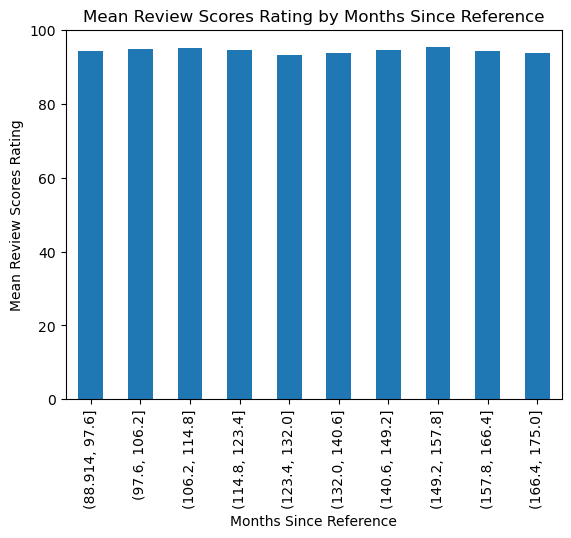

In [525]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(df2['months_since_reference'], bins=10)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('Months Since Reference')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by Months Since Reference')
plt.show()

In [483]:
df2.groupby(['host_has_profile_pic'])['review_scores_rating'].mean()

host_has_profile_pic
f    97.800000
t    94.534112
Name: review_scores_rating, dtype: float64

In [494]:
g0 = df2.loc[df2['host_has_profile_pic'] == 'f', 'review_scores_rating'].values
g1 = df2.loc[df2['host_has_profile_pic'] == 't', 'review_scores_rating'].values

In [495]:
def calculate_pvalue(group1, group2):
    _, pvalue = stats.ttest_ind(group1, group2, nan_policy='omit')
    return pvalue

In [496]:
calculate_pvalue(g0, g1)

0.2694062607489123

In [497]:
df2['host_total_listings_count'].value_counts(dropna=False)

1.0      2179
2.0       620
3.0       261
4.0       151
5.0        98
34.0       67
6.0        48
48.0       46
169.0      39
37.0       37
36.0       36
7.0        30
9.0        28
10.0       26
8.0        23
11.0       22
21.0       21
18.0       19
17.0       16
12.0       12
13.0       12
354.0      10
19.0        4
163.0       4
15.0        3
502.0       2
NaN         2
84.0        2
Name: host_total_listings_count, dtype: int64

In [498]:
df2.groupby(['host_total_listings_count'])['review_scores_rating'].mean()

host_total_listings_count
1.0      95.279748
2.0      94.233273
3.0      94.938865
4.0      93.983740
5.0      93.988235
6.0      94.179487
7.0      90.826087
8.0      92.227273
9.0      93.814815
10.0     94.826087
11.0     87.666667
12.0     95.714286
13.0     97.750000
15.0     91.333333
17.0     87.300000
18.0     92.526316
19.0     80.000000
21.0     92.761905
34.0     86.338462
36.0     92.931034
37.0     89.857143
48.0     97.121951
84.0     91.500000
163.0    97.500000
169.0    93.648649
354.0    90.000000
502.0    67.500000
Name: review_scores_rating, dtype: float64

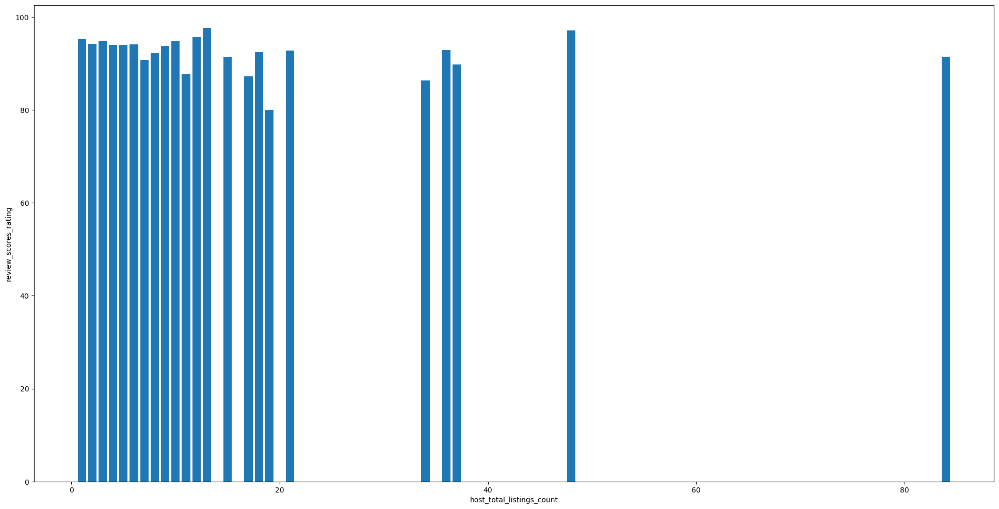

In [517]:
x_data = h['host_total_listings_count']
y_data = h['review_scores_rating']
plt.figure(figsize=(24, 12))
plt.bar(x_data, y_data)

# Set labels for x and y axes
plt.xlabel('host_total_listings_count')
plt.ylabel('review_scores_rating')

# Show the plot
plt.show()

In [515]:
#h=df2[['host_total_listings_count', 'review_scores_rating']]

h= df2.loc[df2['host_total_listings_count']<100].groupby('host_total_listings_count')['review_scores_rating'].mean()
h= h.reset_index()

In [516]:
h

,host_total_listings_count,review_scores_rating
0,1.0,95.279748
1,2.0,94.233273
2,3.0,94.938865
3,4.0,93.983740
4,5.0,93.988235
5,6.0,94.179487
6,7.0,90.826087
7,8.0,92.227273
8,9.0,93.814815
9,10.0,94.826087


In [518]:
h.shape

(23, 2)

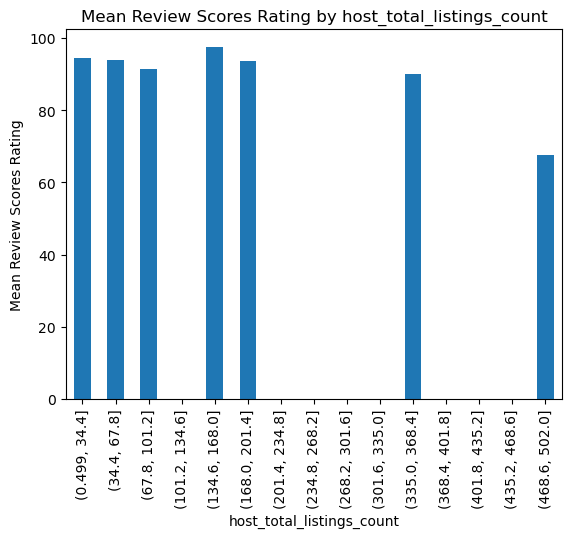

In [529]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(df2['host_total_listings_count'], bins=15)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('host_total_listings_count')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by host_total_listings_count')
plt.show()

In [520]:
df2['host_response_rate'].value_counts(dropna=False)

100%    2371
NaN      523
90%      165
80%      104
99%       78
88%       66
50%       52
94%       46
67%       41
89%       32
75%       32
86%       30
98%       28
96%       28
70%       25
97%       21
60%       20
83%       20
93%       18
92%       18
33%       14
40%       12
63%       11
71%        8
95%        8
78%        8
91%        5
43%        4
64%        3
76%        3
87%        3
25%        3
57%        2
82%        2
17%        2
58%        2
53%        1
65%        1
69%        1
68%        1
30%        1
56%        1
38%        1
81%        1
31%        1
55%        1
Name: host_response_rate, dtype: int64

In [521]:
g1= df2.groupby('host_response_rate')['review_scores_rating'].mean()
g1= g1.reset_index()

In [546]:
g1['host_response_rate'].dtypes

dtype('O')

In [548]:
g1['host_response_rate']= g1['host_response_rate'].str.replace('%', '')

In [553]:
g1['host_response_rate']= pd.to_numeric(g1['host_response_rate'])

In [554]:
sorted_df= g1.sort_values(by='host_response_rate')
sorted_df

,host_response_rate,review_scores_rating
1,17,100.000000
2,25,97.500000
3,30,100.000000
4,31,97.000000
5,33,90.818182
6,38,100.000000
7,40,73.142857
8,43,85.750000
9,50,94.257143
10,53,94.000000


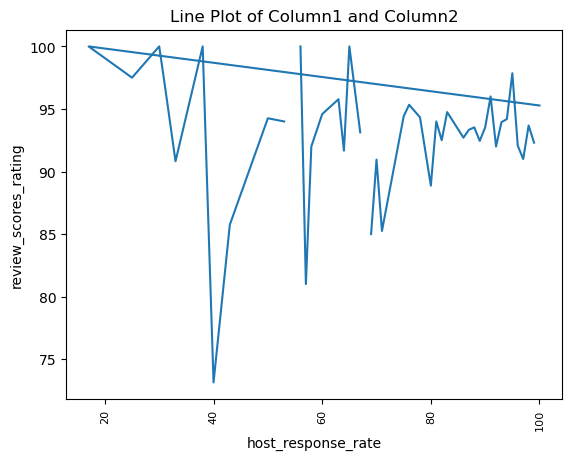

In [555]:
# Plot the line plot
plt.plot(g1['host_response_rate'], g1['review_scores_rating'])

# Add labels and title
plt.xlabel('host_response_rate')
plt.ylabel('review_scores_rating')
plt.title('Line Plot of Column1 and Column2')

plt.xticks(rotation='vertical', ha='center', fontsize=8)

# Show the plot
plt.show()

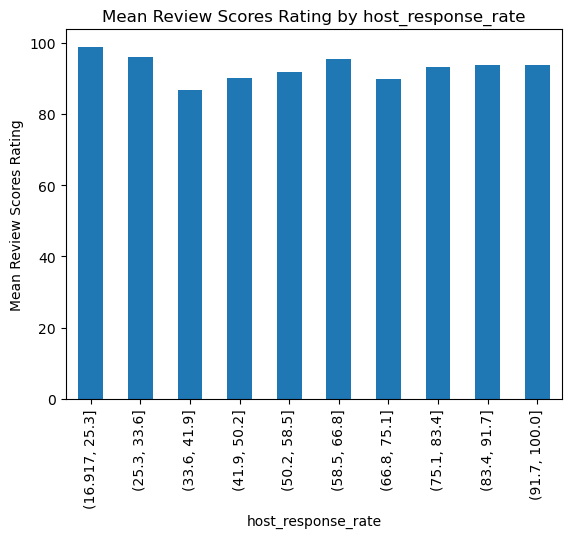

In [559]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(g1['host_response_rate'], bins=10)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = g1.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('host_response_rate')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by host_response_rate')
plt.show()

In [561]:
list(df2.columns)

['id',
 'listing_url',
 'scrape_id',
 'last_scraped',
 'name',
 'summary',
 'space',
 'description',
 'experiences_offered',
 'neighborhood_overview',
 'notes',
 'transit',
 'thumbnail_url',
 'medium_url',
 'picture_url',
 'xl_picture_url',
 'host_id',
 'host_url',
 'host_name',
 'host_since',
 'host_location',
 'host_about',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_thumbnail_url',
 'host_picture_url',
 'host_neighbourhood',
 'host_listings_count',
 'host_total_listings_count',
 'host_verifications',
 'host_has_profile_pic',
 'host_identity_verified',
 'street',
 'neighbourhood',
 'neighbourhood_cleansed',
 'neighbourhood_group_cleansed',
 'city',
 'state',
 'zipcode',
 'market',
 'smart_location',
 'country_code',
 'country',
 'latitude',
 'longitude',
 'is_location_exact',
 'property_type',
 'room_type',
 'accommodates',
 'bathrooms',
 'bedrooms',
 'beds',
 'bed_type',
 'amenities',
 'square_feet',
 'price',
 'weekly_price',


In [ ]:
cancellation_policy

In [563]:
df2['cancellation_policy'].value_counts(dropna=False)

strict      1417
moderate    1251
flexible    1150
Name: cancellation_policy, dtype: int64

In [570]:
df2.groupby('cancellation_policy')['review_scores_rating'].mean()

cancellation_policy
flexible    94.810256
moderate    94.671958
strict      94.251392
Name: review_scores_rating, dtype: float64

In [564]:
df2['city'].value_counts(dropna=False)

Seattle                  3810
West Seattle                2
Seattle                     2
Ballard, Seattle            1
西雅图                         1
Phinney Ridge Seattle       1
seattle                     1
Name: city, dtype: int64

In [565]:
df2['number_of_reviews'].value_counts(dropna=False)

0      627
1      310
2      224
4      160
3      157
      ... 
179      1
138      1
190      1
270      1
128      1
Name: number_of_reviews, Length: 195, dtype: int64

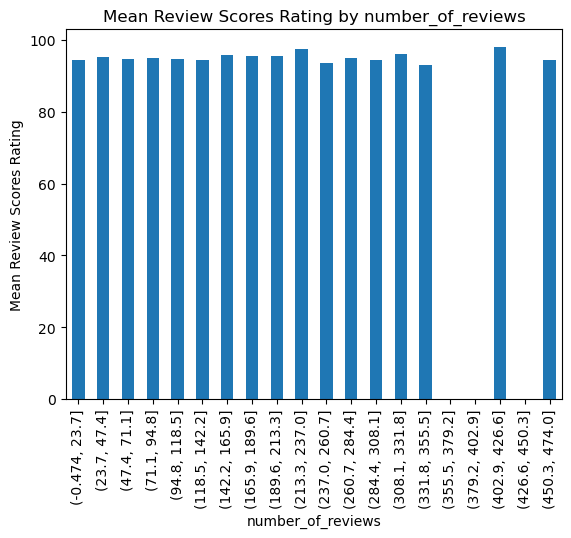

In [573]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(df2['number_of_reviews'], bins=20)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('number_of_reviews')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by number_of_reviews')
plt.show()

In [566]:
df2['accommodates'].value_counts(dropna=False)

2     1627
4      785
3      398
6      332
1      256
5      184
8      119
7       52
10      25
12      15
9       13
16       4
11       3
14       3
15       2
Name: accommodates, dtype: int64

In [568]:
df2.groupby('accommodates')['review_scores_rating'].mean()

accommodates
1     93.284153
2     94.843036
3     94.552023
4     94.503900
5     94.123457
6     94.605634
7     94.714286
8     93.214286
9     97.909091
10    91.956522
11    97.000000
12    95.133333
14    95.666667
15    97.000000
16    97.500000
Name: review_scores_rating, dtype: float64

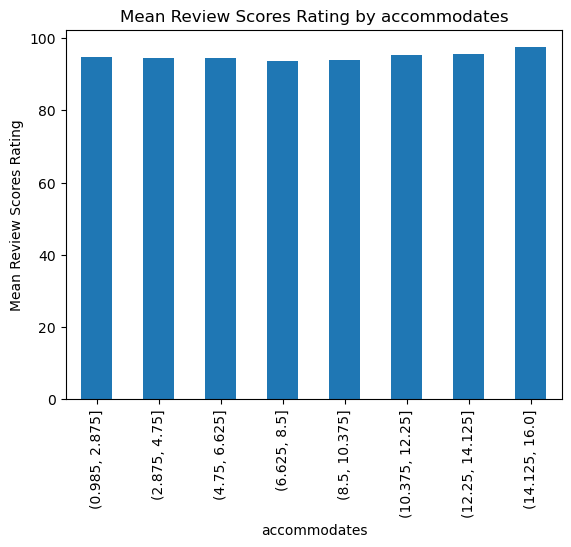

In [574]:
# Create intervals for 'months_since_reference'
intervals = pd.cut(df2['accommodates'], bins=8)

# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby(intervals)['review_scores_rating'].mean()

# Plot the bar chart
grouped_df.plot(kind='bar')
plt.xlabel('accommodates')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by accommodates')
plt.show()

In [633]:
import textwrap
# Group by the intervals and calculate the mean of 'review_scores_rating'
grouped_df = df2.groupby('neighbourhood')['review_scores_rating'].mean()
new_df= pd.DataFrame({'neighbourhood': grouped_df.index, 'mean_rating': grouped_df.values})
new_df = new_df.sort_values(by='mean_rating', ascending=False)


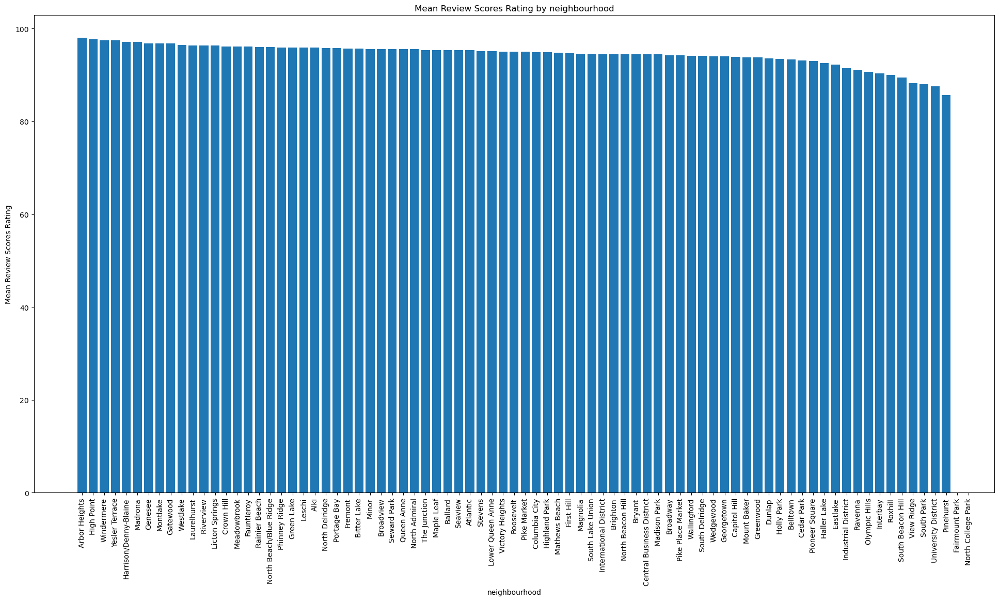

In [634]:
# Plot the bar chart
x_data = new_df['neighbourhood']
y_data = new_df['mean_rating']
plt.figure(figsize=(24, 12))
plt.bar(x_data, y_data)
plt.xticks(rotation=90)
plt.xlabel('neighbourhood')
plt.ylabel('Mean Review Scores Rating')
plt.title('Mean Review Scores Rating by neighbourhood')

plt.show()

In [636]:
list(df2.columns)


['id',
 'listing_url',
 'scrape_id',
 'last_scraped',
 'name',
 'summary',
 'space',
 'description',
 'experiences_offered',
 'neighborhood_overview',
 'notes',
 'transit',
 'thumbnail_url',
 'medium_url',
 'picture_url',
 'xl_picture_url',
 'host_id',
 'host_url',
 'host_name',
 'host_since',
 'host_location',
 'host_about',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_thumbnail_url',
 'host_picture_url',
 'host_neighbourhood',
 'host_listings_count',
 'host_total_listings_count',
 'host_verifications',
 'host_has_profile_pic',
 'host_identity_verified',
 'street',
 'neighbourhood',
 'neighbourhood_cleansed',
 'neighbourhood_group_cleansed',
 'city',
 'state',
 'zipcode',
 'market',
 'smart_location',
 'country_code',
 'country',
 'latitude',
 'longitude',
 'is_location_exact',
 'property_type',
 'room_type',
 'accommodates',
 'bathrooms',
 'bedrooms',
 'beds',
 'bed_type',
 'amenities',
 'square_feet',
 'price',
 'weekly_price',


In [637]:
df2.head(3)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,...,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,24-Hour Check-in,Air Conditioning,Breakfast,Buzzer/Wireless Intercom,Cable TV,Carbon Monoxide Detector,Cat(s),Dog(s),Doorman,Dryer,Elevator in Building,Essentials,Family/Kid Friendly,Fire Extinguisher,First Aid Kit,Free Parking on Premises,Gym,Hair Dryer,Hangers,Heating,Hot Tub,Indoor Fireplace,Internet,Iron,Kitchen,Laptop Friendly Workspace,Lock on Bedroom Door,Other pet(s),Pets Allowed,Pets live on this property,Pool,Safety Card,Shampoo,Smoke Detector,Smoking Allowed,Suitable for Events,TV,Washer,Washer / Dryer,Wheelchair Accessible,Wireless Internet,months_since_reference
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.636289,-122.371025,t,Apartment,Entire home/apt,...,NaN,WASHINGTON,f,moderate,f,f,2,4.07,0,1,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,142.0
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.639123,-122.365666,t,Apartment,Entire home/apt,...,NaN,WASHINGTON,f,strict,t,t,6,1.48,0,0,0,1,0,1,0,0,0,1,0,1,1,1,1,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,1,0,0,1,1,0,0,1,124.0
2,3308979,https://www.airbnb.com/rooms/3308979,20160104002432,2016-01-04,New Modern House-Amazing water view,New modern house built in 2013. Spectacular s...,"Our house is modern, light and fresh with a wa...",New modern house built in 2013. Spectacular s...,none,Upper Queen Anne is a charming neighborhood fu...,Ou

In [638]:
df2['property_type'].value_counts(dropna=False)


House              1733
Apartment          1708
Townhouse           118
Condominium          91
Loft                 40
Bed & Breakfast      37
Other                22
Cabin                21
Camper/RV            13
Bungalow             13
Boat                  8
Tent                  5
Treehouse             3
Dorm                  2
Chalet                2
Yurt                  1
NaN                   1
Name: property_type, dtype: int64

In [639]:
df2['room_type'].value_counts(dropna=False)

Entire home/apt    2541
Private room       1160
Shared room         117
Name: room_type, dtype: int64

In [642]:
grouped_df = df2.groupby('room_type')['review_scores_rating'].mean()
new_df= pd.DataFrame({'room_type': grouped_df.index, 'mean_rating': grouped_df.values})
new_df = new_df.sort_values(by='mean_rating', ascending=False)


In [643]:
new_df

,room_type,mean_rating
1,Private room,94.802935
0,Entire home/apt,94.477647
2,Shared room,93.228261


In [644]:
grouped_df = df2.groupby('property_type')['review_scores_rating'].mean()
new_df= pd.DataFrame({'property_type': grouped_df.index, 'mean_rating': grouped_df.values})
new_df = new_df.sort_values(by='mean_rating', ascending=False)
new_df

,property_type,mean_rating
15,Yurt,100.000000
3,Bungalow,97.666667
13,Townhouse,96.625000
11,Other,96.263158
4,Cabin,96.238095
14,Treehouse,96.000000
1,Bed & Breakfast,95.730769
5,Camper/RV,95.700000
2,Boat,95.600000
10,Loft,95.454545
